In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import numpy as np

In [16]:
df = pd.read_csv(r"C:\Users\Admin\Downloads\archive\FoodData.csv")
df.head(4)

,Class,Type,Group,Food,Allergy
0,Plant origin,Nut and seed,Oil seed,Almond,Nut Allergy
1,Plant origin,Fruit,Pome fruit,Apple,Oral Allergy Syndrome
2,Plant origin,Fruit,Stone fruit,Apricot,Stone Fruit Allergy
3,Plant origin,Vegetable,Composite vegetable,Artichoke,Insulin Allergy


In [23]:
df.isnull().sum()

Class      0
Type       0
Group      0
Food       0
Allergy    0
dtype: int64

In [18]:
df['Allergy']=df['Allergy'].fillna('Unknown')   #For unknown values

In [19]:
df['Allergy'].unique()

array(['Nut Allergy', 'Oral Allergy Syndrome', 'Stone Fruit Allergy',
       'Insulin Allergy', 'Allium Allergy', 'Histamine Allergy',
       'Banana Allergy', 'Gluten Allergy', 'Legume Allergy',
       'Salicylate Allergy', 'Broccoli allergy', 'Cruciferous Allergy',
       'Ragweed Allergy', 'Milk allergy / Lactose intolerance',
       'Mushroom Allergy', 'Unknown', 'Hypersensitivity',
       'Alpha-gal Syndrome', 'Poultry Allergy', 'Ochratoxin Allergy',
       'Corn Allergy', 'Seed Allergy', 'Shellfish Allergy',
       'Fish Allergy', 'Nightshade Allergy',
       'Sugar Allergy / Intolerance', 'LTP Allergy', 'Citrus Allergy',
       'Honey Allergy', 'Beer Allergy', 'Potato Allergy',
       'Lactose Intolerance', 'Aquagenic Urticaria', 'Peanut Allergy',
       'Mint Allergy', 'Rice Allergy', 'Pepper Allergy', 'Soy Allergy',
       'Tannin Allergy', 'Thyroid'], dtype=object)

<Axes: title={'center': 'Allergy Count'}, xlabel='Allergy'>

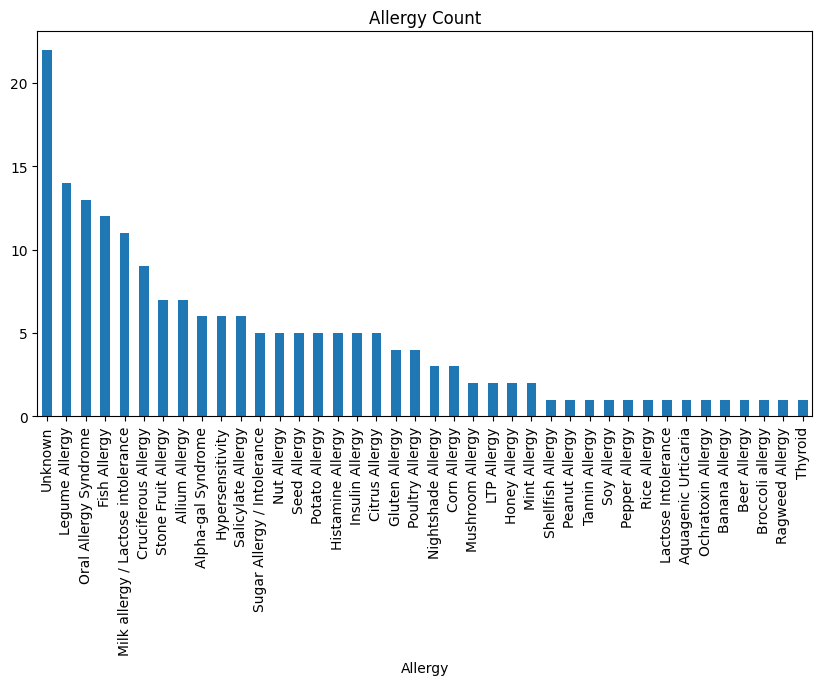

In [8]:
df['Allergy'].value_counts().plot(kind='bar',figsize=(10,5),title='Allergy Count')

In [8]:
#Text to Features 
cat_features = ['Food','Allergy','Type','Class','Group']
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
for features in cat_features:
    df[features] = le.fit_transform(df[features])

In [9]:
df.head()

,Class,Type,Group,Food,Allergy
0,2,7,21,0,22
1,2,4,22,1,24
2,2,4,28,2,35
3,2,13,5,3,14
4,2,13,15,4,0


In [10]:
X = df.drop(columns=['Allergy'])
y = df['Allergy']

In [17]:
print(X.shape)
print(y.shape)

(184, 4)
(184,)


In [11]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)
print(X_train.shape)
print(y_train.shape)

(128, 4)
(128,)


In [21]:
rf_model = RandomForestClassifier()
rf_model.fit(X_train,y_train)

RandomForestClassifier()

In [24]:
from sklearn.metrics import accuracy_score
rf_pred = rf_model.predict(X_test)
rf_accuracy = accuracy_score(rf_pred,y_test)
print(f"Random Classifier has accuracy : {rf_accuracy:4f}")

Random Classifier has accuracy : 0.660714


In [30]:
from sklearn.linear_model import LogisticRegression
lr_model = LogisticRegression()
lr_model.fit(X_train,y_train)
lr_pred = lr_model.predict(X_test)
lr_accuracy = accuracy_score(lr_pred,y_test)
print(f"Accuracy : {lr_accuracy:.4f}")

Accuracy : 0.2321


C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [26]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
}

grid = GridSearchCV(RandomForestClassifier(random_state=42), param_grid, cv=5)
grid.fit(X_train, y_train)

print("Best params:", grid.best_params_)
print("Best CV score:", grid.best_score_)

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Best params: {'max_depth': None, 'n_estimators': 50}
Best CV score: 0.7578461538461538


In [28]:
from sklearn.svm import SVC
svm_model = SVC()
svm_model.fit(X_train,y_train)
svm_pred = svm_model.predict(X_test)
svm_accuracy = accuracy_score(y_test,svm_pred)
print(f"SVM Accuracy : {svm_accuracy:.4f}")

SVM Accuracy : 0.1607


In [31]:
from sklearn.tree import DecisionTreeClassifier
dt_mod = DecisionTreeClassifier()
dt_mod.fit(X_train,y_train)
dt_pred = dt_mod.predict(X_test)
dt_accuracy = accuracy_score(y_test,dt_pred)
print(f"Decision Tree accuracy: {dt_accuracy:.4f}")

Decision Tree accuracy: 0.6607


In [38]:
print("Train labels:", np.unique(y_train))

Train labels: [ 0  1  3  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27 28 31
 32 33 34 35 36 37 38 39]


In [ ]:
import lightgbm as lgb

lgb_clf = lgb.LGBMClassifier()
lgb_clf.fit(X_train, y_train)
lgb_pred = lgb_clf.predict(X_test)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000651 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 78
[LightGBM] [Info] Number of data points in the train set: 128, number of used features: 4
[LightGBM] [Info] Start training from score -3.060271
[LightGBM] [Info] Start training from score -3.060271
[LightGBM] [Info] Start training from score -4.852030
[LightGBM] [Info] Start training from score -3.242592
[LightGBM] [Info] Start training from score -4.158883
[LightGBM] [Info] Start training from score -3.060271
[LightGBM] [Info] Start training from score -2.654806
[LightGBM] [Info] Start training from score -3.753418
[LightGBM] [Info] Start training from score -3.242592
[LightGBM] [Info] Start training from score -3.753418
[LightGBM] [Info] Start training from score -3.753418
[LightGBM] [Info] Start training from score -4.158883
[Lig

In [41]:
lgb_accuracy=accuracy_score(lgb_pred,y_test)
print(f"LGB accuracy:{lgb_accuracy:.4f}")

LGB accuracy:0.7143


In [42]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(hidden_layer_sizes=(64, 64), max_iter=300)
mlp.fit(X_train, y_train)

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(hidden_layer_sizes=(64, 64), max_iter=300)

In [43]:
mlp_pred = mlp.predict(X_test)
mlp_acc = accuracy_score(mlp_pred,y_test)
print(f"Accuracy of MLP Classifier : {mlp_acc:.4f}")

Accuracy of MLP Classifier : 0.3929


In [44]:
from sklearn.model_selection import RandomizedSearchCV
import lightgbm as lgb

param_dist = {
    'num_leaves': [31, 50, 70],
    'max_depth': [-1, 10, 20, 30],
    'learning_rate': [0.01, 0.05, 0.1],
    'n_estimators': [100, 200, 500],
    'min_child_samples': [20, 30, 50]
}

lgbm = lgb.LGBMClassifier()
random_search = RandomizedSearchCV(lgbm, param_distributions=param_dist, n_iter=20, cv=3, scoring='accuracy', verbose=2)
random_search.fit(X_train, y_train)

print("Best params:", random_search.best_params_)
print("Best score:", random_search.best_score_)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 85, number of used features: 3
[LightGBM] [Info] Start training from score -3.056357
[LightGBM] [Info] Start training from score -3.056357
[LightGBM] [Info] Start training from score -4.442651
[LightGBM] [Info] Start training from score -3.344039
[LightGBM] [Info] Start training from score -3.749504
[LightGBM] [Info] Start training from score -3.056357
[LightGBM] [Info] Start training from score -2.650892
[LightGBM] [Info] Start training from score -3.749504
[LightGBM] [Info] Start training from score -3.056357
[LightGBM] [Info] Start training from score -3.749504
[LightGBM] [Info] Start training from score -3.74950

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\model_selection\_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [45]:
from sklearn.metrics import f1_score

rf_f1  = f1_score(y_test, rf_model.predict(X_test), average='micro')  
lgb_f1 = f1_score(y_test, lgb_pred, average='micro')
dt_f1 = f1_score(y_test, dt_pred, average='micro')

print(f"RF   F1: {rf_f1:.4f}")
print(f"LGBM F1: {lgb_f1:.4f}")
print(f"DT F1: {dt_f1:.4f}")

RF   F1: 0.6607
LGBM F1: 0.7143
DT F1: 0.6607


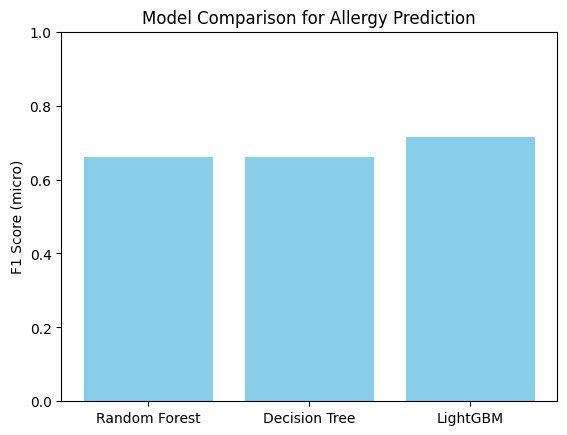

In [46]:
import matplotlib.pyplot as plt

models = ['Random Forest', 'Decision Tree', 'LightGBM']
scores = [rf_f1, dt_f1, lgb_f1]

plt.bar(models, scores, color='skyblue')
plt.ylabel('F1 Score (micro)')
plt.title('Model Comparison for Allergy Prediction')
plt.ylim(0, 1)
plt.show()


In [48]:
import joblib
best_model = lgb_clf
joblib.dump(best_model, 'final_allergy_model.pkl')

['final_allergy_model.pkl']

In [2]:
import joblib
loaded_model = joblib.load('final_allergy_model.pkl')